### Prediction Types

__Unlabeled Prediction Types:__

|              | Ensemble agrees | Ensemble disagrees |
|--------------|:-------------:|:------:|
| __Low entropy__  |  type A | type C |
| __High entropy__ |  type B | type D |

- `A` - Easy cases, not interesting, maybe for keeping the data distribution roughly correct 
- `B` - Interesting cases, many of them would fall into "not sure" category. Can add this to training set as uncertain samples (so should be informative).
- `C` - Entropy here is way bigger than for predictions where ensemble agrees. Ensemble prediction is usually right. Can use this to add some auto-labeled data, still useful because some models predicted wrong.
- `D` - Interesting cases, similar to type C. Ensemble prediction not necessarily right.  Can add this to training set as uncertain samples (so should be informative).

__Train Prediction Types:__
- `NOTSURE` - *low_entropy, label NOTSURE* - almost surely correctly predicted, makes sense to add ones where some model in ensemble mispredicts. This helps decide if the image is HQ or LQ.
- `MISPREDICTION` - *mispredicted on train set at least with one model* - potential for mislabel detection.
- `UNCERTAIN` - *high entropy, correctly predicted* - potential for mislabel detection.

 
### Next iteration data updates

- Misprediction - manual       - usually all (<20) - fix labeling mistakes
- Uncertain     - manual.      - 50max  - fix labeling mistakes
- Not sure      - autolabel    - 100max - go from undecided to some specific label using machine suggestion
- Type C        - autolabel    - 100max - add images which are uncertain (for ensemble), autolabeling used
- Type B+D      - manual label - 50max - add generally uncertain images

In [ ]:
# Parameters
exp_name = $EXP_NAME # Iteration folder

# Constant-ish parameters
root_dir = $ROOT_DIR  # Where experiment folders are
train_img_dir = $TRAIN_IMG_DIR
unlabeled_img_dir = $UNLABELED_IMG_DIR

label_file_name = "labels.json"

inference_train_folder = "inference_train"
inference_unlabeled_folder = "inference_unlabeled"

notsure_max_entropy = 1e-4
samples_to_show = 5 # Usually 25 or 50, 5 is to keep notebook size small for github

## Get JSON files with predictions to analyze

In [ ]:
import os
import json

# Load labels
label_file_path = os.path.join(root_dir, exp_name, label_file_name)
with open(label_file_path) as f:
    labels = json.load(f)

# Get train set inference predictions
inference_train_folder_path = os.path.join(root_dir, exp_name, inference_train_folder)
inference_train_jsons = sorted(
    [os.path.join(inference_train_folder_path, f) for f in os.listdir(inference_train_folder_path) if f.endswith('.json')]
)
# Get unlabeled set inference predictions
inference_unlabeled_folder_path = os.path.join(root_dir, exp_name, inference_unlabeled_folder)
inference_unlabeled_jsons = sorted(
    [os.path.join(inference_unlabeled_folder_path, f) for f in os.listdir(inference_unlabeled_folder_path) if f.endswith('.json')]
)

len(labels), inference_train_jsons, inference_unlabeled_jsons

## Extract predictions from files

In [3]:
import numpy as np

def softmax(x):
    x = np.array(x)
    x = np.exp(x) / np.sum(np.exp(x))
    return x

def get_predictions_from_jsons(json_files):
    all_predictions = {}
    for file in json_files:
        with open(file) as f:
            predictions = json.load(f)
        for img_id, p in predictions.items():
            if img_id not in all_predictions:
                all_predictions[img_id] = []
            all_predictions[img_id].append(softmax(p))
    return all_predictions

# Get all the predictions, per image.
train_set_predictions = get_predictions_from_jsons(inference_train_jsons)
unlabeled_set_predictions = get_predictions_from_jsons(inference_unlabeled_jsons)

# Remove predictions from unlabeled set which are already in labeled set.
unlabeled_set_predictions = {k: v for k, v in unlabeled_set_predictions.items() if k not in train_set_predictions}
                                                       
len(train_set_predictions), len(unlabeled_set_predictions)

(2941, 7669)

## Get mispredictions in a train set and predictions on "don't care" samples. 

In [4]:
notsure_predictions, mispredictions, uncertain_predictions = [], [], []

for img_id, ensemble_predictions in list(train_set_predictions.items()):
    # Compute average entropy of ensemble predictions.
    entropy = np.mean([np.sum(-x * np.log(x)) for x in ensemble_predictions])
    # Go from logits to predicted class.
    predictions = [int(np.argmax(x)) for x in ensemble_predictions]
    # Store predictions for "not sure" samples.
    if labels[img_id] == 2:
        notsure_predictions.append((img_id, entropy, predictions))
    # Store predictions which are predicted incorrectly by some model.
    elif labels[img_id] != predictions[0] or len(set(predictions)) > 1:
        mispredictions.append((img_id, entropy, predictions, labels[img_id]))
    else:
        uncertain_predictions.append((img_id, entropy, predictions, labels[img_id]))
        
# Sort predictions by entropy, decreasing.
notsure_predictions = sorted(notsure_predictions, key=lambda x: x[1], reverse=False)
mispredictions = sorted(mispredictions, key=lambda x: x[1], reverse=True)
uncertain_predictions = sorted(uncertain_predictions, key=lambda x: x[1], reverse=True)
len(notsure_predictions), len(mispredictions), len(uncertain_predictions)

(26, 2, 2913)

## Get type b, c and d predictions for unlabeled set

In [5]:
## Separate predictions into confusing and sure.
print(len(unlabeled_set_predictions))
type_c_predictions, type_b_d_predictions = [], []
for img_id, ensemble_predictions in list(unlabeled_set_predictions.items()):
    # Compute average entropy of ensemble predictions.
    entropy = np.mean([np.sum(-x * np.log(x)) for x in ensemble_predictions])
    # Go from logits to predicted class.
    preds = [int(np.argmax(x)) for x in ensemble_predictions]
    # Store only predictions which are not 100% agreed on within ensemble.
    if len(set(preds)) > 1:
        type_c_predictions.append((img_id, entropy, preds))
    # For type B and D, we need all the predictions.
    type_b_d_predictions.append((img_id, entropy, preds))
    
# Sort predictions by entropy, decreasing.
type_c_predictions = sorted(type_c_predictions, key=lambda x: x[1], reverse=False)
type_b_d_predictions = sorted(type_b_d_predictions, key=lambda x: x[1], reverse=True)
len(type_c_predictions), len(type_b_d_predictions)

7669


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in multiply
  


(339, 7669)

## Show mispredictions

In [6]:
from IPython.display import display, Image
from IPython.html.widgets.interaction import interact, fixed

def get_image(img_id, img_dir):
    img_path = os.path.join(img_dir, '{}.jpeg'.format(img_id))
    return img_path

/usr/local/lib/python3.7/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


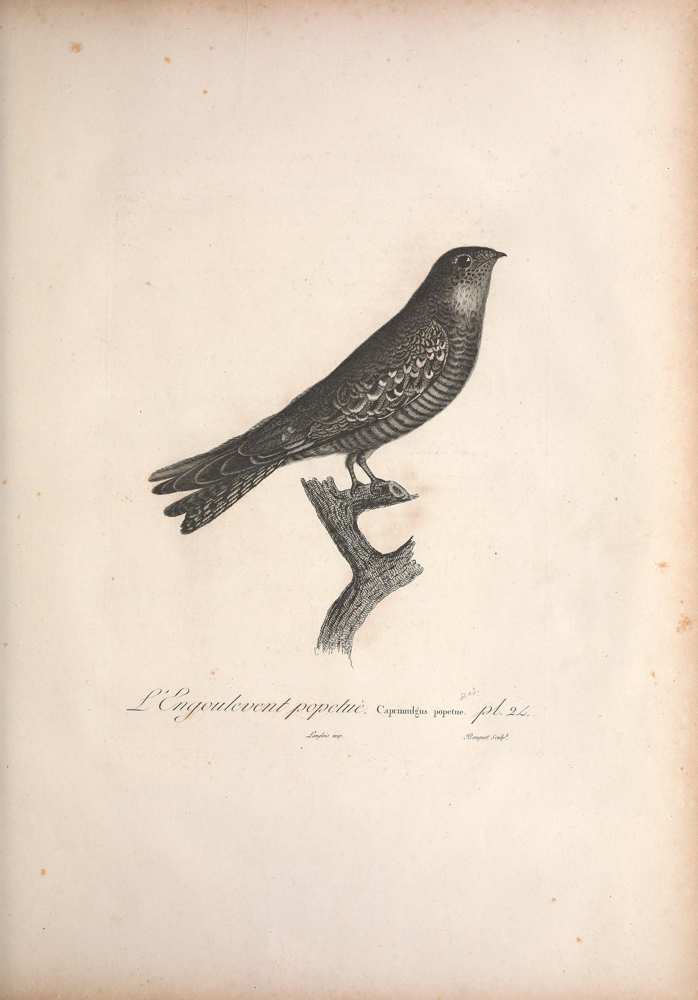

47005666 0.1434220870925765 [1, 0, 0, 0, 0] 0


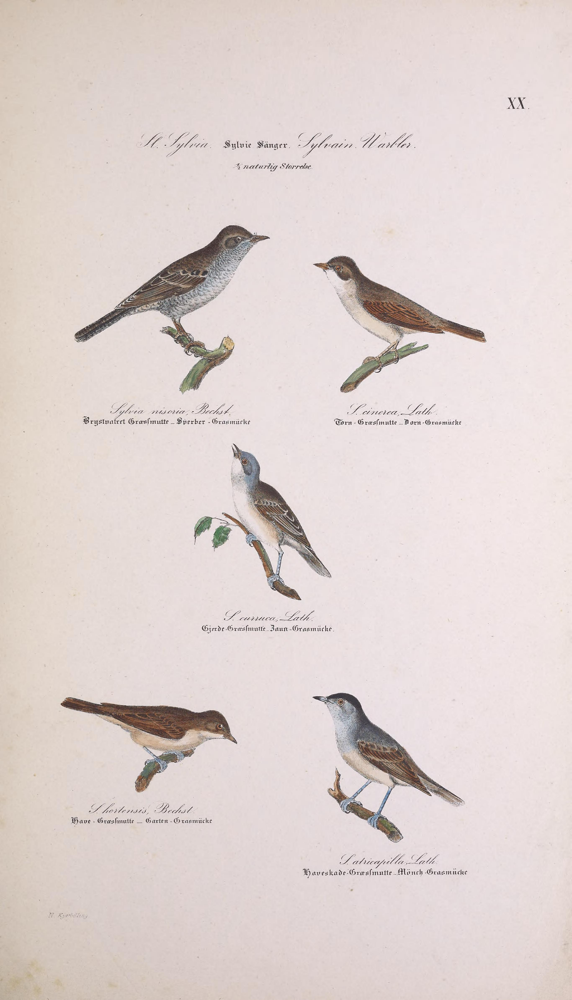

40094844 0.0632520087070912 [0, 0, 0, 1, 0] 0


In [19]:
for img_id, entropy, predictions, label in mispredictions[:5]:
    display(Image(get_image(img_id, train_img_dir), width=200))
    print(img_id, entropy, predictions, label)
    
# NOTE: In case there are mislabels in mispredictions, they need to be fixed manually by modifying labels.json

## Show uncertain predictions (correct, but uncertain)

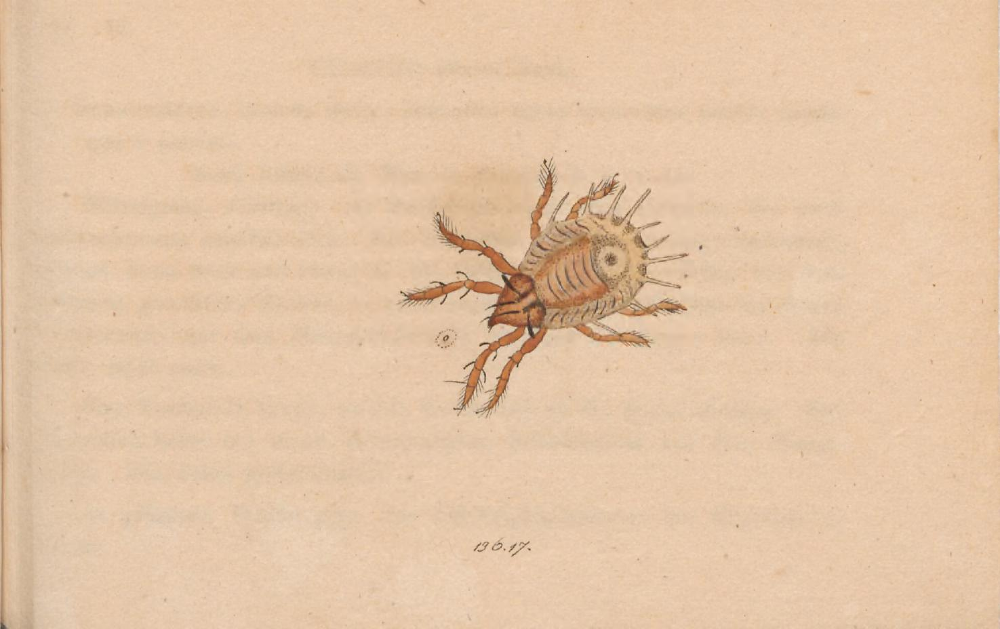

56630641 0.13912042867629193 [0, 0, 0, 0, 0] 0


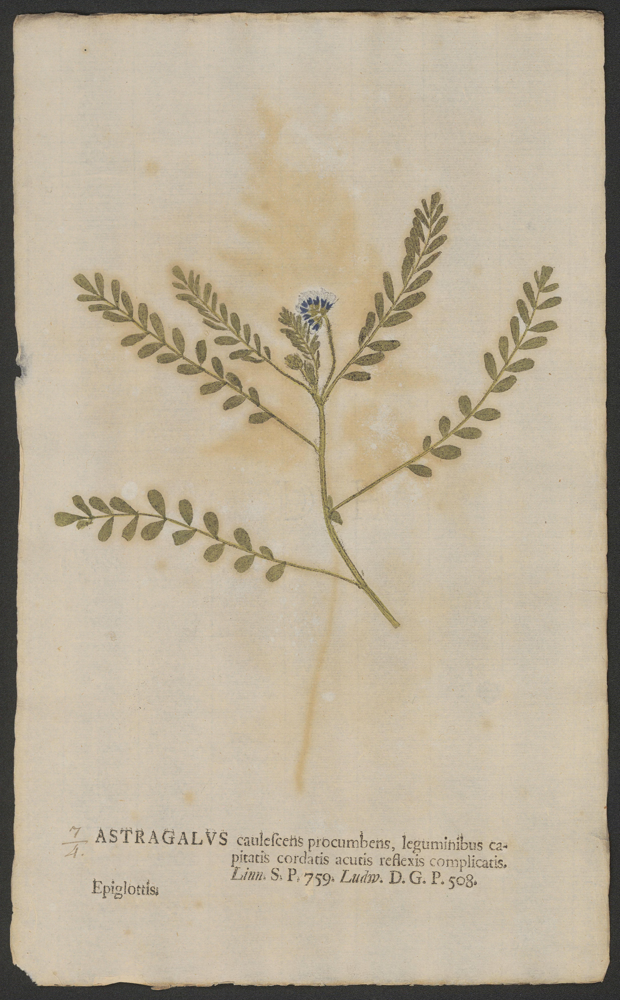

53903558 0.13841050400098168 [0, 0, 0, 0, 0] 0


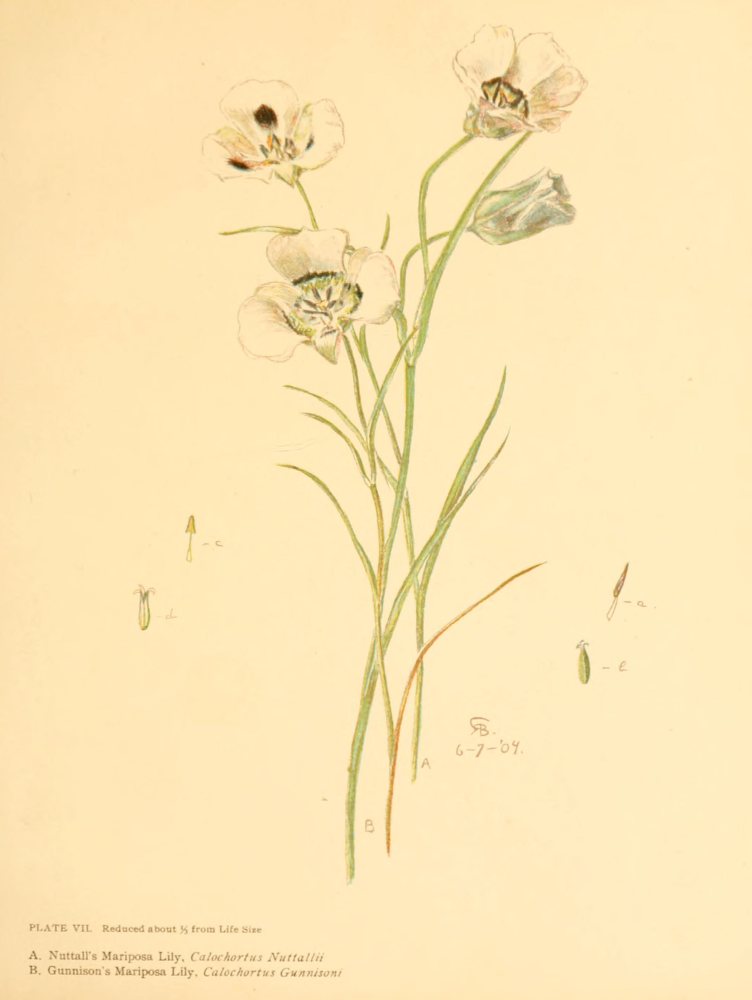

16487999 0.13698957676634826 [0, 0, 0, 0, 0] 0


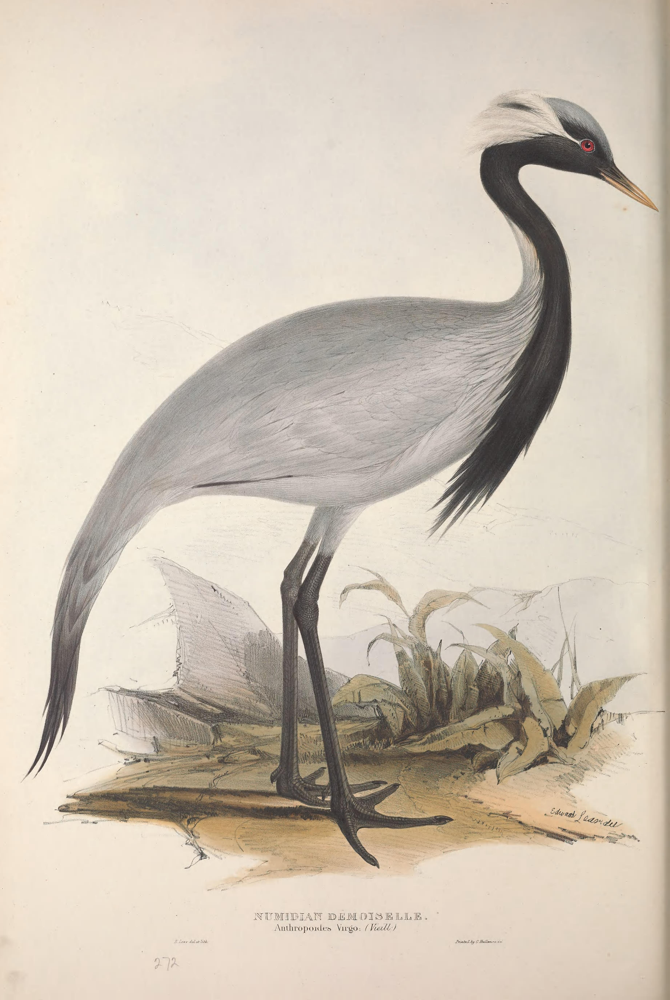

42173907 0.12665499142776218 [0, 0, 0, 0, 0] 0


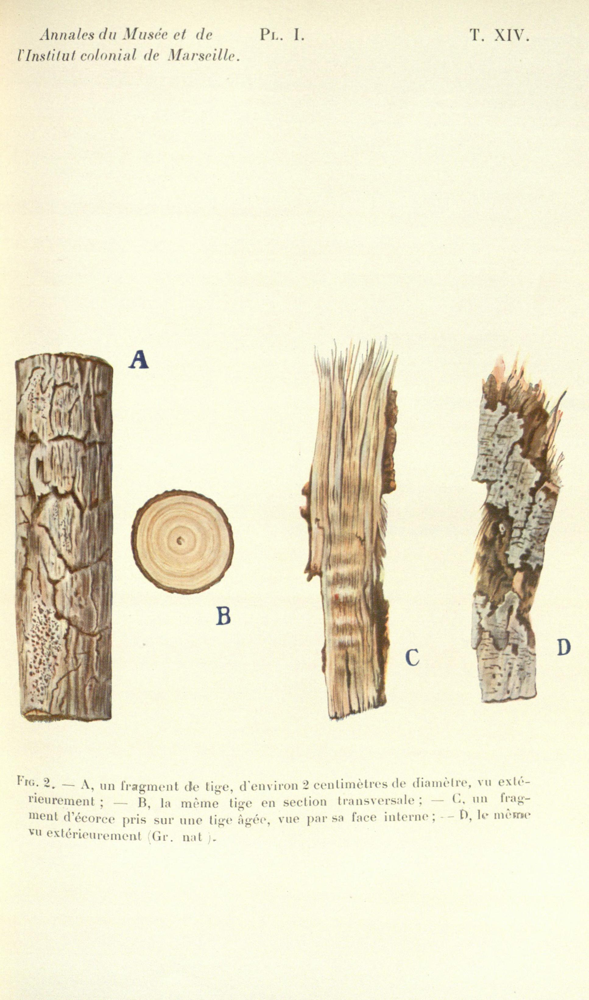

45349854 0.12244739235072148 [1, 1, 1, 1, 1] 1


In [18]:
for img_id, entropy, predictions, label in uncertain_predictions[:5]:
    display(Image(get_image(img_id, train_img_dir), width=200))
    print(img_id, entropy, predictions, label)
    
# NOTE: In case there are mislabels in uncertain predictions, they need to be fixed manually by modifying labels.json

## Show "not sure" predictions

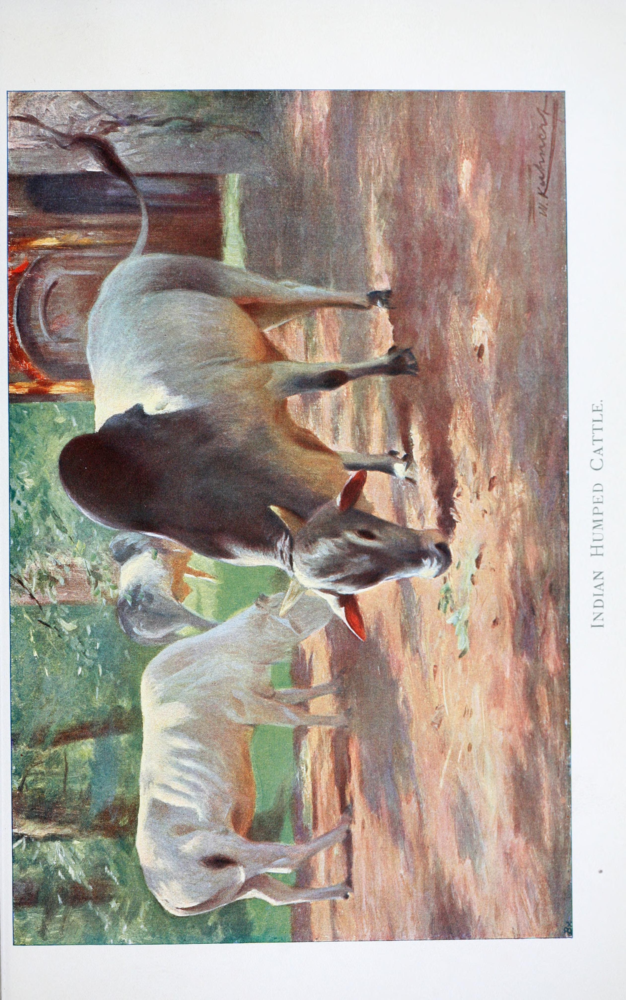

21738770 1.1755659197979188e-08 [0, 0, 0, 0, 0] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

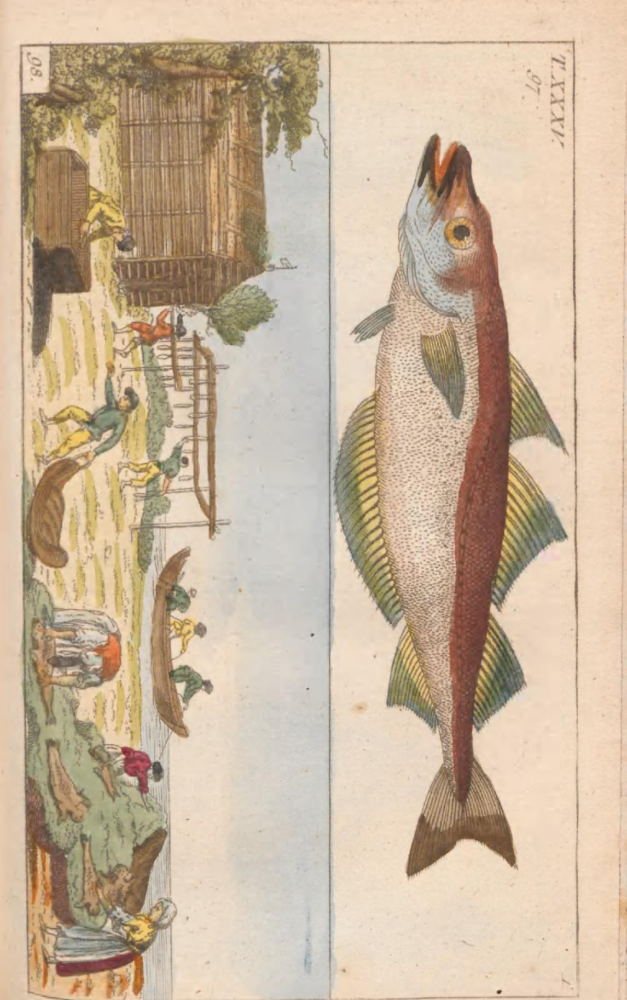

51850100 1.394847502360793e-07 [0, 0, 0, 0, 0] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

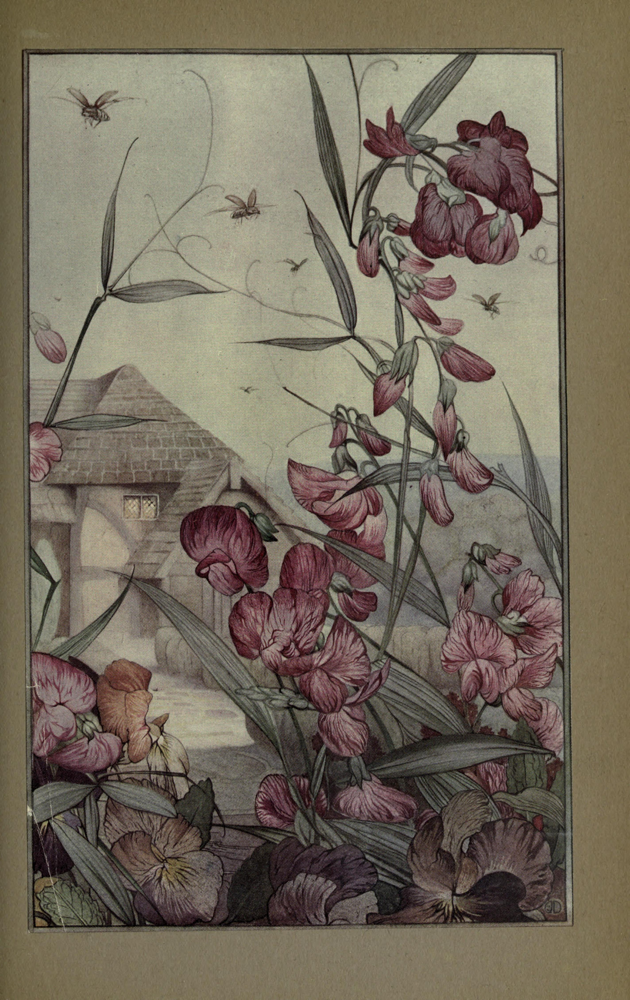

24189622 1.4897938839378565e-06 [0, 0, 0, 0, 0] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

In [17]:
relabels_notsure = []
for img_id, entropy, predictions in notsure_predictions[:5]:
    if entropy > notsure_max_entropy:
        break
    display(Image(get_image(img_id, train_img_dir), width=200))
    ensemble_prediction = 0 if sum(predictions) < 3 else 1
    print(img_id, entropy, predictions, ensemble_prediction)
    def add_prediction_for_relabeling(relabel, img_id, ensemble_prediction):
        if relabel:
            relabels_notsure.append((img_id, ensemble_prediction))
        else:
            relabels_notsure.remove((img_id, ensemble_prediction))
    interact(
        add_prediction_for_relabeling,
        relabel=True,
        img_id=fixed(img_id),
        ensemble_prediction=fixed(ensemble_prediction)
    )
# NOTE: Need to filter manually that ensemble is correct and that I agree (no longer don't care)

In [ ]:
notsure_relabels_path = os.path.join(root_dir, exp_name, "relabel_notsure.json")
with open(notsure_relabels_path, 'w') as f:
    json.dump(relabels_notsure, f)

## Show type C predictions - low output entropy, but ensemble disagrees

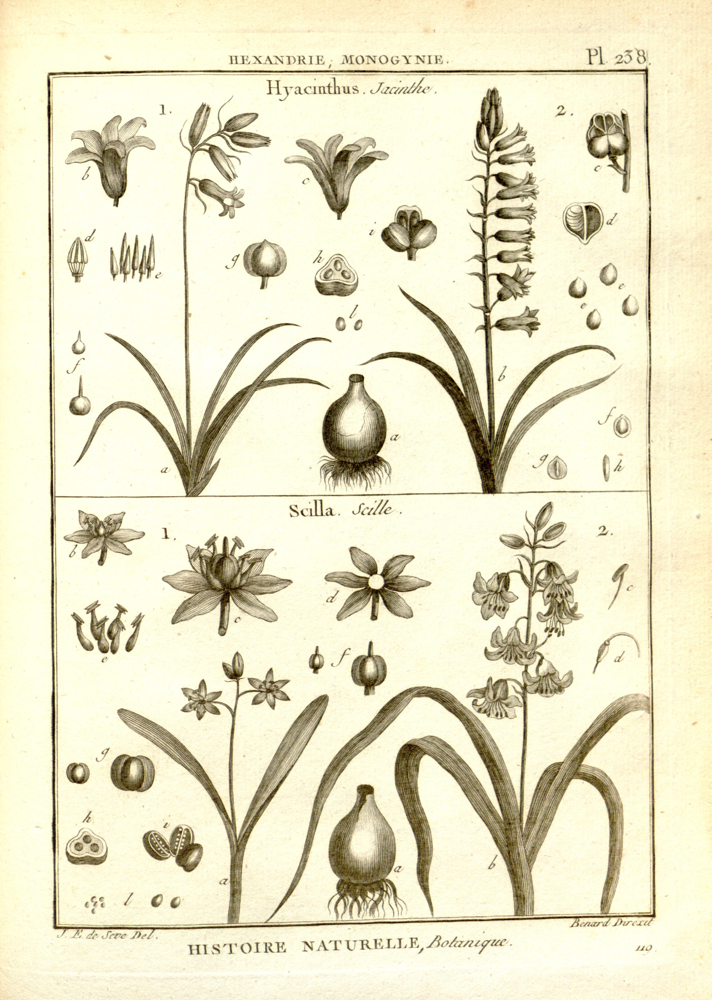

787260 6.577378867325525e-05 [1, 1, 0, 1, 1] 1


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

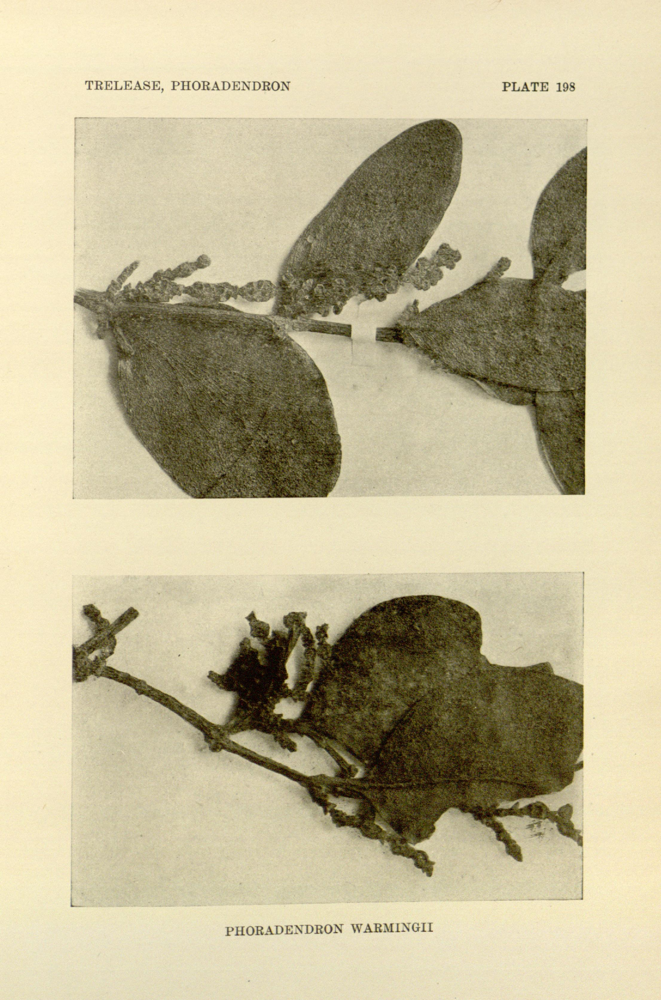

6027423 0.00021994729866602115 [1, 1, 0, 1, 1] 1


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

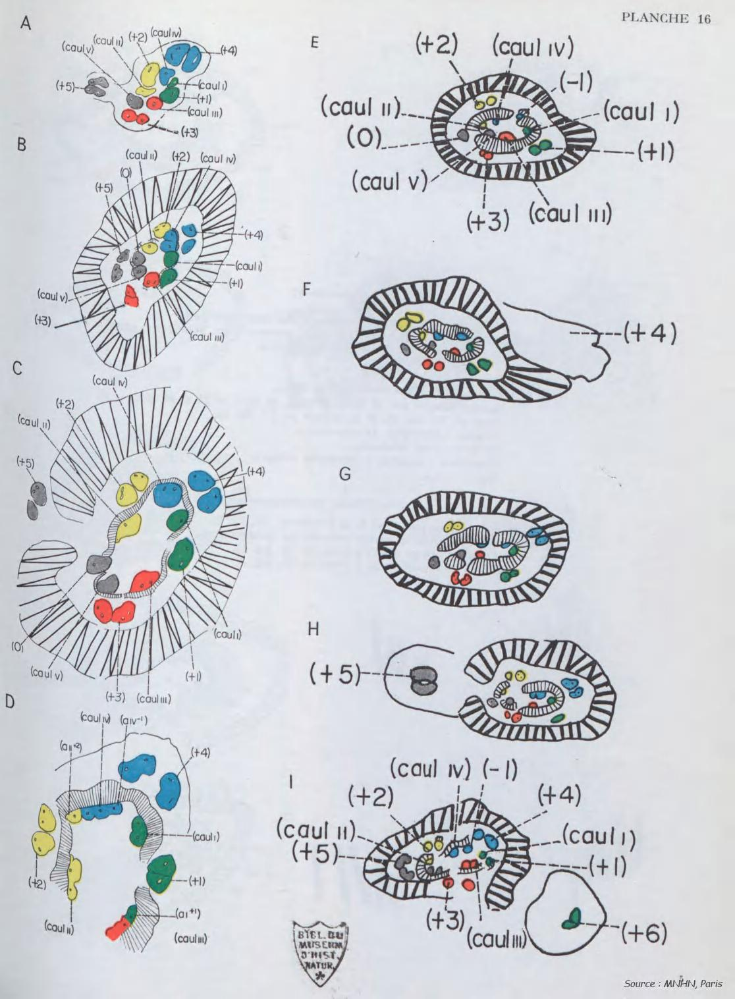

58950179 0.0002634607887355879 [1, 0, 0, 0, 1] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

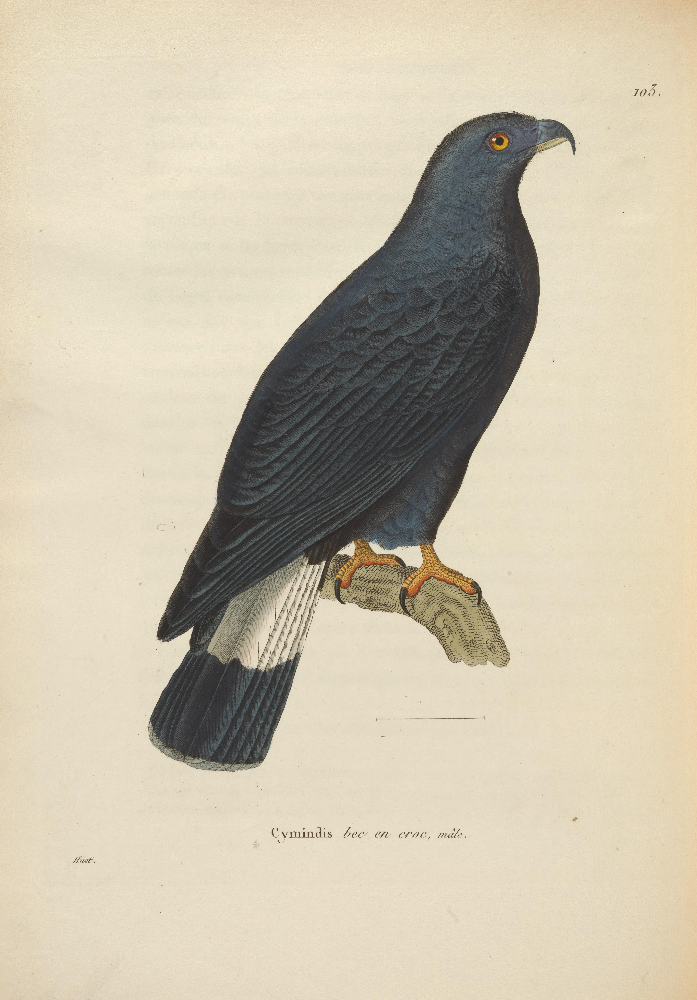

35245583 0.0002916232092248541 [0, 0, 0, 1, 0] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

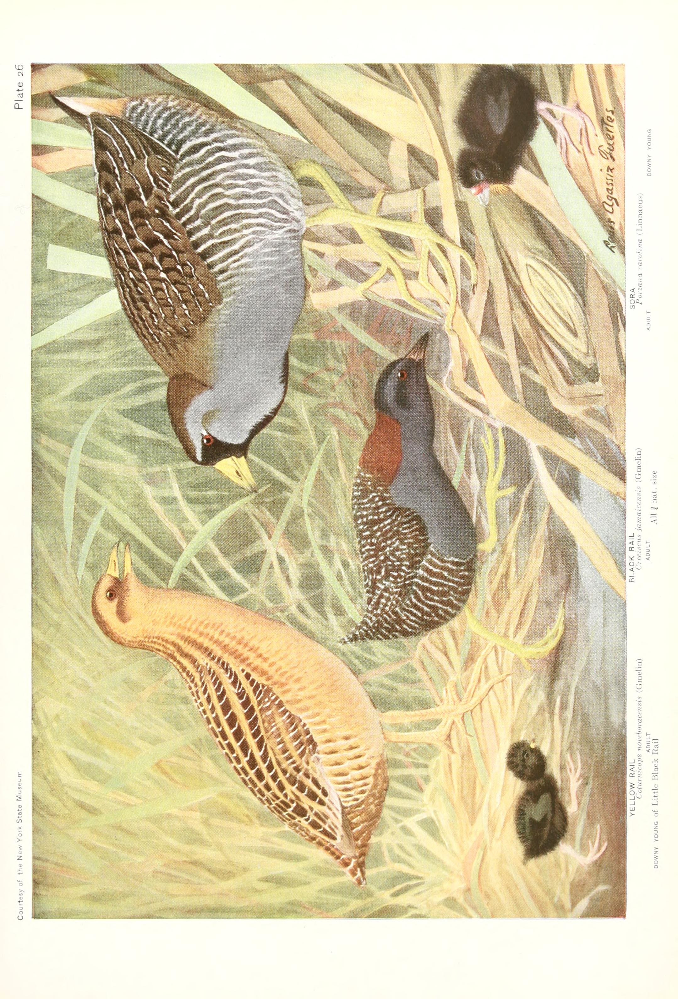

7821573 0.0003270559530481295 [1, 0, 0, 0, 0] 0


interactive(children=(Checkbox(value=True, description='relabel'), Output()), _dom_classes=('widget-interact',…

In [16]:
relabels_type_c = []
for img_id, entropy, predictions in type_c_predictions[:5]:
    #if entropy > 1e-2:
    #    break
    display(Image(get_image(img_id, unlabeled_img_dir), width=200))
    ensemble_prediction = 0 if sum(predictions) < 3 else 1
    print(img_id, entropy, predictions, ensemble_prediction)
    def add_prediction_for_relabeling(relabel, img_id, ensemble_prediction):
        if relabel:
            relabels_type_c.append((img_id, ensemble_prediction))
        else:
            relabels_type_c.remove((img_id, ensemble_prediction))
    interact(
        add_prediction_for_relabeling,
        relabel=True,
        img_id=fixed(img_id),
        ensemble_prediction=fixed(ensemble_prediction)
    )
# NOTE: Need to filter manually that ensemble is correct

In [ ]:
type_c_relabels_path = os.path.join(root_dir, exp_name, "relabel_type_c.json")
with open(type_c_relabels_path, 'w') as f:
    json.dump(relabels_type_c, f)

## Show type B and D predictions

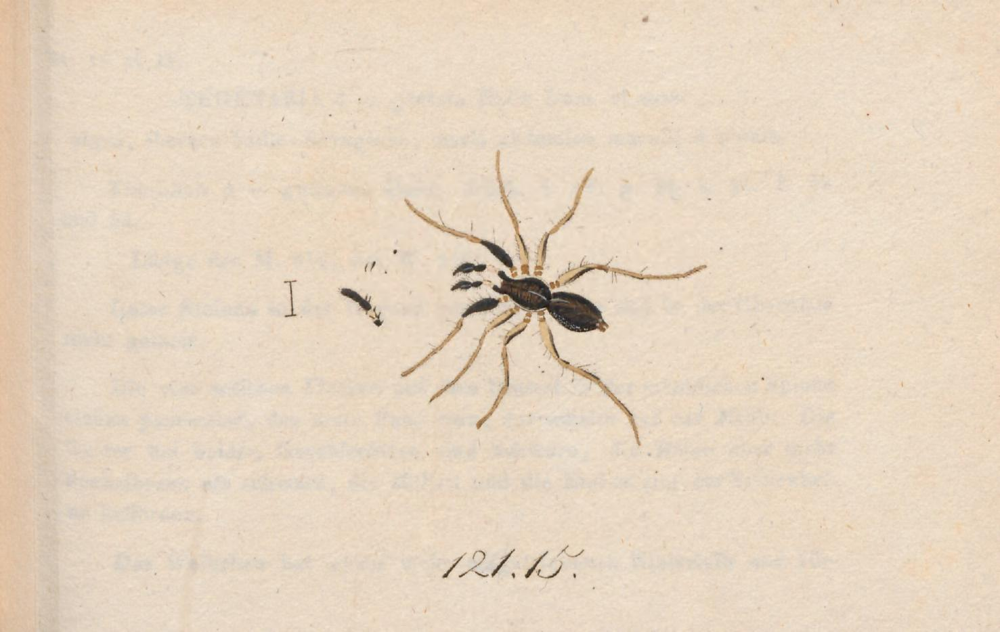

56692324 0.5443509850704007 [0, 0, 1, 0, 0]


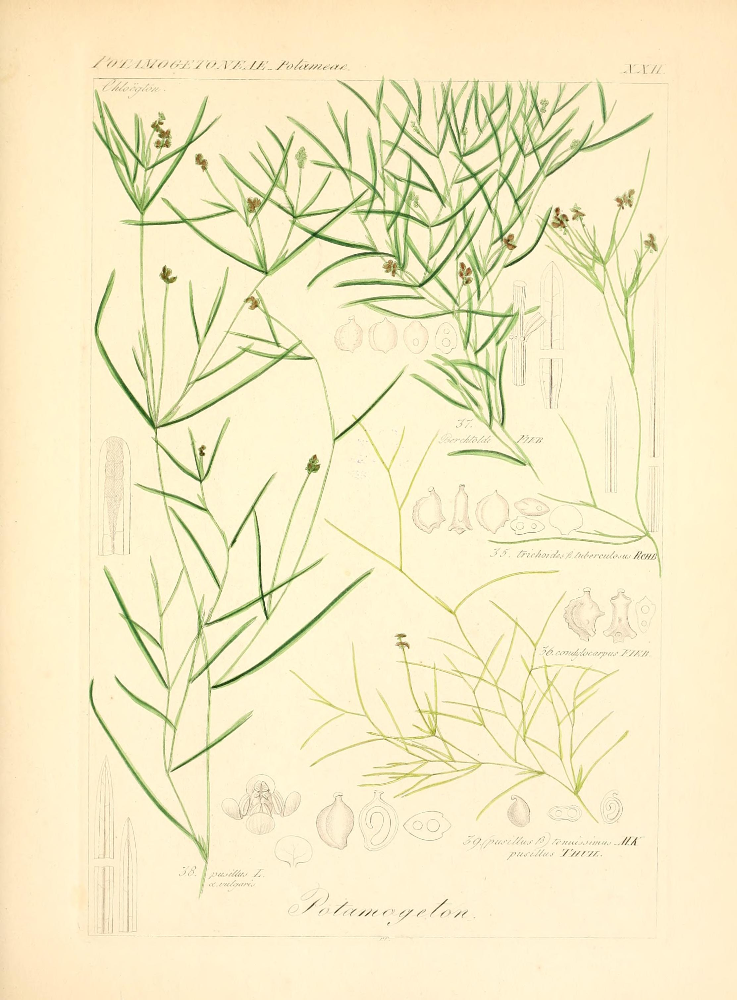

6528433 0.4305811080988999 [0, 1, 1, 1, 1]


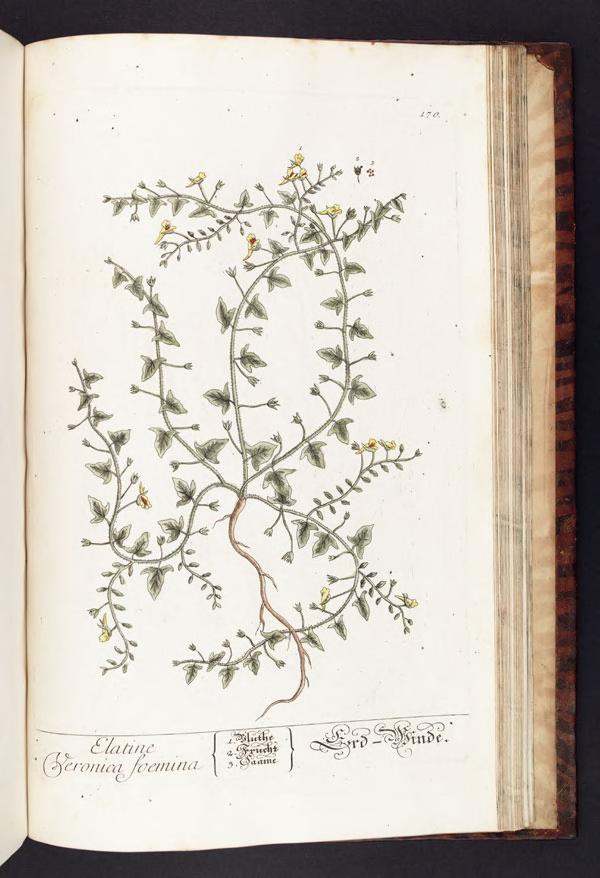

291483 0.4069005414415475 [1, 0, 0, 0, 0]


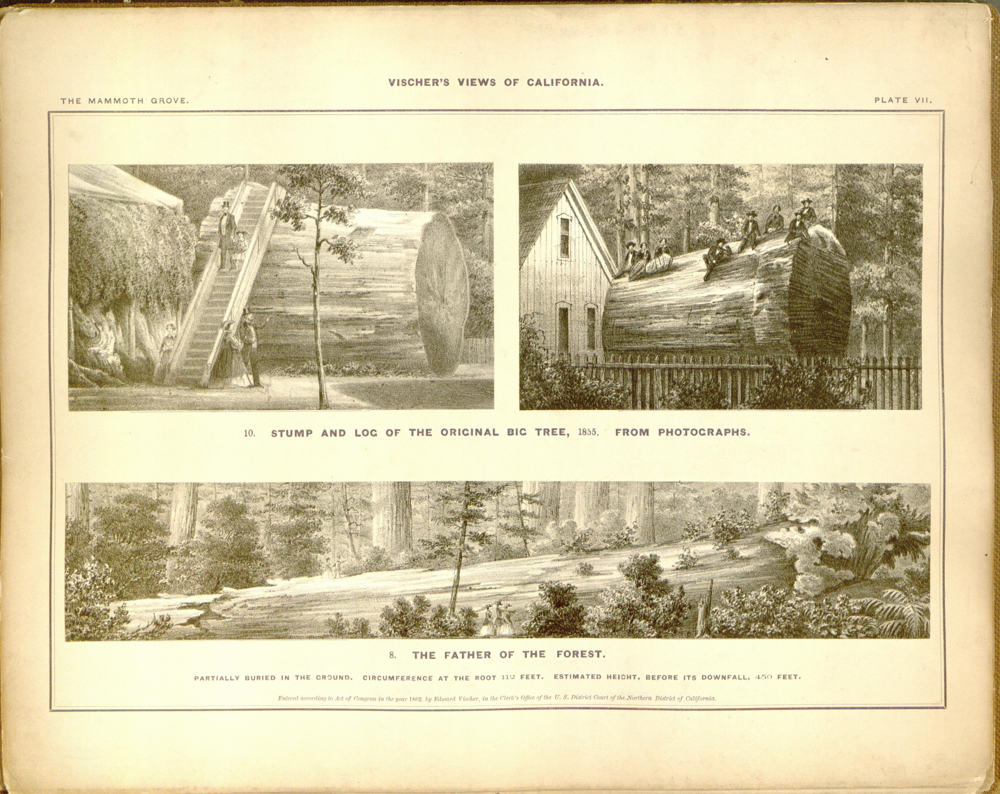

34581635 0.40060846694998864 [1, 1, 1, 1, 0]


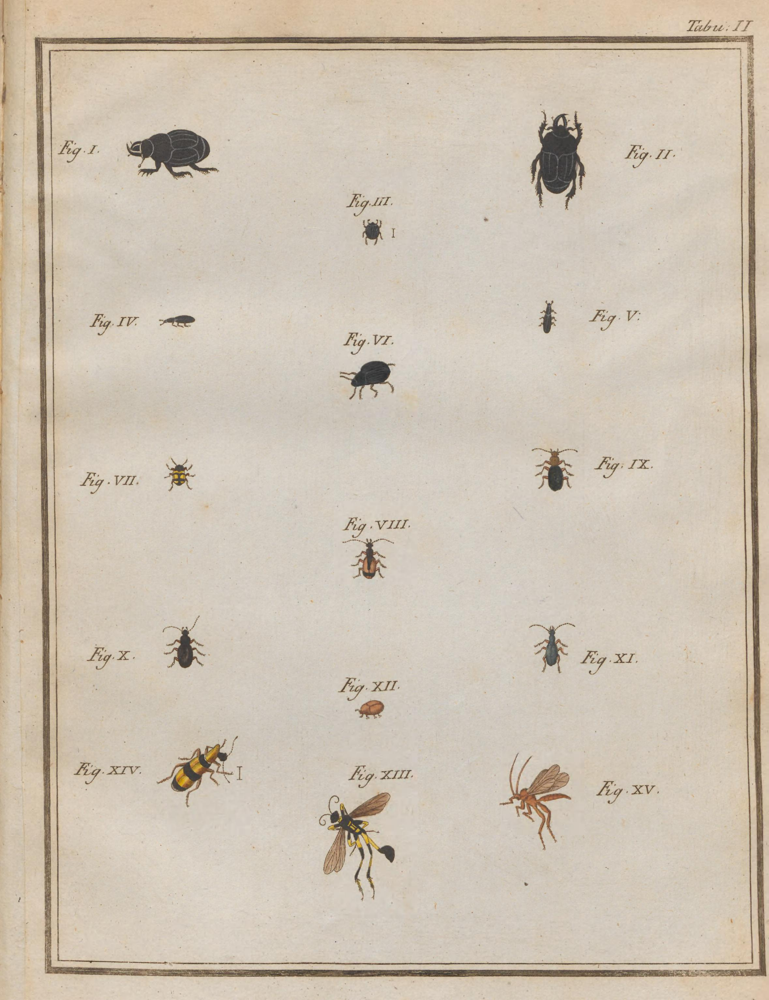

53095746 0.3812781948850331 [0, 1, 0, 1, 0]


In [15]:
relabels_type_b_d = []
for img_id, entropy, predictions in type_b_d_predictions[:5]:
    display(Image(get_image(img_id, unlabeled_img_dir), width=200))
    print(img_id, entropy, predictions)
    ensemble_prediction = 0 if sum(predictions) < 3 else 1
    relabels_type_b_d.append((img_id, ))

# NOTE: Don't need to filter anything

In [ ]:
type_b_d_relabels_path = os.path.join(root_dir, exp_name, "relabel_type_b_d.json")
with open(type_b_d_relabels_path, 'w') as f:
    json.dump(relabels_type_b_d, f)

## Train set analysis

In [ ]:
positive_samples = []
negative_samples = []
dontcare_samples = []
for img_id, label in labels.items():
    if label == 0:
        positive_samples.append(img_id)
    elif label == 1:
        negative_samples.append(img_id)
    else:
        dontcare_samples.append(img_id)

In [ ]:
for img_id in positive_samples[-100:]:
    display(Image(get_image(img_id, train_img_dir), width=200))
    print(img_id)